In [2]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px


#DATA_DIR = r"C:\Users\dalia\OneDrive\Bureau\CM M2\machine learning\projet ML DL\archive"   
DATA_DIR = r"C:\Users\cande\Downloads\archive"

In [3]:
FILES = {
    "global": "GlobalTemperatures.csv",
    "country": "GlobalLandTemperaturesByCountry.csv",
    "state": "GlobalLandTemperaturesByState.csv",
    "major_city": "GlobalLandTemperaturesByMajorCity.csv",
    "city": "GlobalLandTemperaturesByCity.csv",  # le gros
}

def safe_read_csv(path):
    try:
        return pd.read_csv(path, sep = ',' , encoding="utf-8-sig")
    except UnicodeDecodeError:
        return pd.read_csv(path,sep = ',',  encoding="latin1")

dfs_raw = {}
for k, f in FILES.items():
    path = os.path.join(DATA_DIR, f)
    dfs_raw[k] = safe_read_csv(path)
    print(f"✅ Loaded {k}: {dfs_raw[k].shape}")


✅ Loaded global: (3192, 9)
✅ Loaded country: (577462, 4)
✅ Loaded state: (645675, 5)
✅ Loaded major_city: (239177, 7)
✅ Loaded city: (8599212, 7)


In [4]:
def quick_profile(df, name, date_col="dt", max_cols=12):
    print(f"\n{'='*60}\n📌 DATASET: {name}\n{'='*60}")
    print("Shape:", df.shape)
    print("\nColumns:", list(df.columns))
    print("\nDtypes (first 12):")
    print(df.dtypes.head(max_cols))
    print("\nMissing values (top 12):")
    print(df.isna().sum().sort_values(ascending=False).head(12))
    print("\nFirst 5 rows:")
    display(df.head(5))  

    if date_col in df.columns:
        dt = pd.to_datetime(df[date_col], errors="coerce")
        print("\nDate range:", dt.min(), "->", dt.max())

for name, df in dfs_raw.items():
    quick_profile(df, name)



📌 DATASET: global
Shape: (3192, 9)

Columns: ['dt', 'LandAverageTemperature', 'LandAverageTemperatureUncertainty', 'LandMaxTemperature', 'LandMaxTemperatureUncertainty', 'LandMinTemperature', 'LandMinTemperatureUncertainty', 'LandAndOceanAverageTemperature', 'LandAndOceanAverageTemperatureUncertainty']

Dtypes (first 12):
dt                                            object
LandAverageTemperature                       float64
LandAverageTemperatureUncertainty            float64
LandMaxTemperature                           float64
LandMaxTemperatureUncertainty                float64
LandMinTemperature                           float64
LandMinTemperatureUncertainty                float64
LandAndOceanAverageTemperature               float64
LandAndOceanAverageTemperatureUncertainty    float64
dtype: object

Missing values (top 12):
LandMaxTemperatureUncertainty                1200
LandAndOceanAverageTemperature               1200
LandMaxTemperature                           1200
LandMinT

,dt,LandAverageTemperature,LandAverageTemperatureUncertainty,LandMaxTemperature,LandMaxTemperatureUncertainty,LandMinTemperature,LandMinTemperatureUncertainty,LandAndOceanAverageTemperature,LandAndOceanAverageTemperatureUncertainty
0,1750-01-01,3.034,3.574,NaN,NaN,NaN,NaN,NaN,NaN
1,1750-02-01,3.083,3.702,NaN,NaN,NaN,NaN,NaN,NaN
2,1750-03-01,5.626,3.076,NaN,NaN,NaN,NaN,NaN,NaN
3,1750-04-01,8.490,2.451,NaN,NaN,NaN,NaN,NaN,NaN
4,1750-05-01,11.573,2.072,NaN,NaN,NaN,NaN,NaN,NaN



Date range: 1750-01-01 00:00:00 -> 2015-12-01 00:00:00

📌 DATASET: country
Shape: (577462, 4)

Columns: ['dt', 'AverageTemperature', 'AverageTemperatureUncertainty', 'Country']

Dtypes (first 12):
dt                                object
AverageTemperature               float64
AverageTemperatureUncertainty    float64
Country                           object
dtype: object

Missing values (top 12):
AverageTemperature               32651
AverageTemperatureUncertainty    31912
dt                                   0
Country                              0
dtype: int64

First 5 rows:


,dt,AverageTemperature,AverageTemperatureUncertainty,Country
0,1743-11-01,4.384,2.294,Åland
1,1743-12-01,NaN,NaN,Åland
2,1744-01-01,NaN,NaN,Åland
3,1744-02-01,NaN,NaN,Åland
4,1744-03-01,NaN,NaN,Åland



Date range: 1743-11-01 00:00:00 -> 2013-09-01 00:00:00

📌 DATASET: state
Shape: (645675, 5)

Columns: ['dt', 'AverageTemperature', 'AverageTemperatureUncertainty', 'State', 'Country']

Dtypes (first 12):
dt                                object
AverageTemperature               float64
AverageTemperatureUncertainty    float64
State                             object
Country                           object
dtype: object

Missing values (top 12):
AverageTemperature               25648
AverageTemperatureUncertainty    25648
dt                                   0
State                                0
Country                              0
dtype: int64

First 5 rows:


,dt,AverageTemperature,AverageTemperatureUncertainty,State,Country
0,1855-05-01,25.544,1.171,Acre,Brazil
1,1855-06-01,24.228,1.103,Acre,Brazil
2,1855-07-01,24.371,1.044,Acre,Brazil
3,1855-08-01,25.427,1.073,Acre,Brazil
4,1855-09-01,25.675,1.014,Acre,Brazil



Date range: 1743-11-01 00:00:00 -> 2013-09-01 00:00:00

📌 DATASET: major_city
Shape: (239177, 7)

Columns: ['dt', 'AverageTemperature', 'AverageTemperatureUncertainty', 'City', 'Country', 'Latitude', 'Longitude']

Dtypes (first 12):
dt                                object
AverageTemperature               float64
AverageTemperatureUncertainty    float64
City                              object
Country                           object
Latitude                          object
Longitude                         object
dtype: object

Missing values (top 12):
AverageTemperature               11002
AverageTemperatureUncertainty    11002
dt                                   0
City                                 0
Country                              0
Latitude                             0
Longitude                            0
dtype: int64

First 5 rows:


,dt,AverageTemperature,AverageTemperatureUncertainty,City,Country,Latitude,Longitude
0,1849-01-01,26.704,1.435,Abidjan,Côte D'Ivoire,5.63N,3.23W
1,1849-02-01,27.434,1.362,Abidjan,Côte D'Ivoire,5.63N,3.23W
2,1849-03-01,28.101,1.612,Abidjan,Côte D'Ivoire,5.63N,3.23W
3,1849-04-01,26.140,1.387,Abidjan,Côte D'Ivoire,5.63N,3.23W
4,1849-05-01,25.427,1.200,Abidjan,Côte D'Ivoire,5.63N,3.23W



Date range: 1743-11-01 00:00:00 -> 2013-09-01 00:00:00

📌 DATASET: city
Shape: (8599212, 7)

Columns: ['dt', 'AverageTemperature', 'AverageTemperatureUncertainty', 'City', 'Country', 'Latitude', 'Longitude']

Dtypes (first 12):
dt                                object
AverageTemperature               float64
AverageTemperatureUncertainty    float64
City                              object
Country                           object
Latitude                          object
Longitude                         object
dtype: object

Missing values (top 12):
AverageTemperature               364130
AverageTemperatureUncertainty    364130
dt                                    0
City                                  0
Country                               0
Latitude                              0
Longitude                             0
dtype: int64

First 5 rows:


,dt,AverageTemperature,AverageTemperatureUncertainty,City,Country,Latitude,Longitude
0,1743-11-01,6.068,1.737,Århus,Denmark,57.05N,10.33E
1,1743-12-01,NaN,NaN,Århus,Denmark,57.05N,10.33E
2,1744-01-01,NaN,NaN,Århus,Denmark,57.05N,10.33E
3,1744-02-01,NaN,NaN,Århus,Denmark,57.05N,10.33E
4,1744-03-01,NaN,NaN,Århus,Denmark,57.05N,10.33E



Date range: 1743-11-01 00:00:00 -> 2013-09-01 00:00:00


In [5]:
def add_time_cols(df):
    df = df.copy()
    df["dt"] = pd.to_datetime(df["dt"], errors="coerce")
    df = df.dropna(subset=["dt"])
    df["year"] = df["dt"].dt.year
    df["month"] = df["dt"].dt.month
    return df

def latlon_to_float(x):
    if pd.isna(x):
        return np.nan
    s = str(x).strip()
    sign = -1 if s[-1] in ["S", "W"] else 1
    try:
        return sign * float(s[:-1])
    except:
        return np.nan


In [6]:
global_clean = add_time_cols(dfs_raw["global"])

global_clean = global_clean[[
    "dt", "year", "month",
    "LandAverageTemperature",
    "LandAverageTemperatureUncertainty",
    "LandMaxTemperature",
    "LandMinTemperature",
    "LandAndOceanAverageTemperature"
]]

global_clean = global_clean.dropna(subset=["LandAverageTemperature"])

print("GLOBAL CLEAN")
print("Shape:", global_clean.shape)
print("Date range:", global_clean["dt"].min(), "→", global_clean["dt"].max())
print("Missing values:\n", global_clean.isna().sum())
global_clean.head(20)


GLOBAL CLEAN
Shape: (3180, 8)
Date range: 1750-01-01 00:00:00 → 2015-12-01 00:00:00
Missing values:
 dt                                      0
year                                    0
month                                   0
LandAverageTemperature                  0
LandAverageTemperatureUncertainty       0
LandMaxTemperature                   1188
LandMinTemperature                   1188
LandAndOceanAverageTemperature       1188
dtype: int64


,dt,year,month,LandAverageTemperature,LandAverageTemperatureUncertainty,LandMaxTemperature,LandMinTemperature,LandAndOceanAverageTemperature
0,1750-01-01,1750,1,3.034,3.574,NaN,NaN,NaN
1,1750-02-01,1750,2,3.083,3.702,NaN,NaN,NaN
2,1750-03-01,1750,3,5.626,3.076,NaN,NaN,NaN
3,1750-04-01,1750,4,8.490,2.451,NaN,NaN,NaN
4,1750-05-01,1750,5,11.573,2.072,NaN,NaN,NaN
5,1750-06-01,1750,6,12.937,1.724,NaN,NaN,NaN
6,1750-07-01,1750,7,15.868,1.911,NaN,NaN,NaN
7,1750-08-01,1750,8,14.750,2.231,NaN,NaN,NaN
8,1750-09-01,1750,9,11.413,2.637,NaN,NaN,NaN
9,1750-10-01,1750,10,6.367,2.668,NaN,NaN,NaN


In [7]:
country_clean = add_time_cols(dfs_raw["country"])

country_clean = country_clean[[
    "dt", "year", "month",
    "Country",
    "AverageTemperature",
    "AverageTemperatureUncertainty"
]]

country_clean = country_clean.dropna(subset=["AverageTemperature"])

print("COUNTRY CLEAN")
print("Shape:", country_clean.shape)
print("Nb countries:", country_clean["Country"].nunique())
print("Date range:", country_clean["dt"].min(), "→", country_clean["dt"].max())
country_clean.head(20)


COUNTRY CLEAN
Shape: (544811, 6)
Nb countries: 242
Date range: 1743-11-01 00:00:00 → 2013-09-01 00:00:00


,dt,year,month,Country,AverageTemperature,AverageTemperatureUncertainty
0,1743-11-01,1743,11,Åland,4.384,2.294
5,1744-04-01,1744,4,Åland,1.530,4.680
6,1744-05-01,1744,5,Åland,6.702,1.789
7,1744-06-01,1744,6,Åland,11.609,1.577
8,1744-07-01,1744,7,Åland,15.342,1.410
10,1744-09-01,1744,9,Åland,11.702,1.517
11,1744-10-01,1744,10,Åland,5.477,1.862
12,1744-11-01,1744,11,Åland,3.407,1.425
13,1744-12-01,1744,12,Åland,-2.181,1.641
14,1745-01-01,1745,1,Åland,-3.850,1.841


In [8]:
state_clean = add_time_cols(dfs_raw["state"])

state_clean = state_clean[[
    "dt", "year", "month",
    "Country", "State",
    "AverageTemperature",
    "AverageTemperatureUncertainty"
]]

state_clean = state_clean.dropna(subset=["AverageTemperature"])

print("STATE CLEAN")
print("Shape:", state_clean.shape)
print("Nb states:", state_clean["State"].nunique())
print("Date range:", state_clean["dt"].min(), "→", state_clean["dt"].max())
state_clean.head(20)


STATE CLEAN
Shape: (620027, 7)
Nb states: 241
Date range: 1743-11-01 00:00:00 → 2013-09-01 00:00:00


,dt,year,month,Country,State,AverageTemperature,AverageTemperatureUncertainty
0,1855-05-01,1855,5,Brazil,Acre,25.544,1.171
1,1855-06-01,1855,6,Brazil,Acre,24.228,1.103
2,1855-07-01,1855,7,Brazil,Acre,24.371,1.044
3,1855-08-01,1855,8,Brazil,Acre,25.427,1.073
4,1855-09-01,1855,9,Brazil,Acre,25.675,1.014
5,1855-10-01,1855,10,Brazil,Acre,25.442,1.179
6,1855-11-01,1855,11,Brazil,Acre,25.400,1.064
7,1855-12-01,1855,12,Brazil,Acre,24.100,1.718
8,1856-01-01,1856,1,Brazil,Acre,25.814,1.159
9,1856-02-01,1856,2,Brazil,Acre,24.658,1.147


In [9]:
major_city_clean = add_time_cols(dfs_raw["major_city"])

major_city_clean = major_city_clean[[
    "dt", "year", "month",
    "City", "Country",
    "Latitude", "Longitude",
    "AverageTemperature",
    "AverageTemperatureUncertainty"
]]

major_city_clean = major_city_clean.dropna(subset=["AverageTemperature"])

major_city_clean["lat"] = major_city_clean["Latitude"].apply(latlon_to_float)
major_city_clean["lon"] = major_city_clean["Longitude"].apply(latlon_to_float)

major_city_clean = major_city_clean.dropna(subset=["lat", "lon"])

print("MAJOR CITY CLEAN")
print("Shape:", major_city_clean.shape)
print("Nb cities:", major_city_clean["City"].nunique())
print("Date range:", major_city_clean["dt"].min(), "→", major_city_clean["dt"].max())
major_city_clean.head(20)


MAJOR CITY CLEAN
Shape: (228175, 11)
Nb cities: 100
Date range: 1743-11-01 00:00:00 → 2013-09-01 00:00:00


,dt,year,month,City,Country,Latitude,Longitude,AverageTemperature,AverageTemperatureUncertainty,lat,lon
0,1849-01-01,1849,1,Abidjan,Côte D'Ivoire,5.63N,3.23W,26.704,1.435,5.63,-3.23
1,1849-02-01,1849,2,Abidjan,Côte D'Ivoire,5.63N,3.23W,27.434,1.362,5.63,-3.23
2,1849-03-01,1849,3,Abidjan,Côte D'Ivoire,5.63N,3.23W,28.101,1.612,5.63,-3.23
3,1849-04-01,1849,4,Abidjan,Côte D'Ivoire,5.63N,3.23W,26.140,1.387,5.63,-3.23
4,1849-05-01,1849,5,Abidjan,Côte D'Ivoire,5.63N,3.23W,25.427,1.200,5.63,-3.23
5,1849-06-01,1849,6,Abidjan,Côte D'Ivoire,5.63N,3.23W,24.844,1.402,5.63,-3.23
6,1849-07-01,1849,7,Abidjan,Côte D'Ivoire,5.63N,3.23W,24.058,1.254,5.63,-3.23
7,1849-08-01,1849,8,Abidjan,Côte D'Ivoire,5.63N,3.23W,23.576,1.265,5.63,-3.23
8,1849-09-01,1849,9,Abidjan,Côte D'Ivoire,5.63N,3.23W,23.662,1.226,5.63,-3.23
9,1849-10-01,1849,10,Abidjan,Côte D'Ivoire,5.63N,3.23W,25.263,1.175,5.63,-3.23


In [10]:
city_clean = add_time_cols(dfs_raw["city"])

city_clean = city_clean[[
    "dt", "year", "month",
    "City", "Country",
    "Latitude", "Longitude",
    "AverageTemperature",
    "AverageTemperatureUncertainty"
]]

city_clean = city_clean.dropna(subset=["AverageTemperature"])

city_clean["lat"] = city_clean["Latitude"].apply(latlon_to_float)
city_clean["lon"] = city_clean["Longitude"].apply(latlon_to_float)

city_clean = city_clean.dropna(subset=["lat", "lon"])


print(city_clean["Country"].unique())

print("CITY CLEAN")
print("Shape:", city_clean.shape)
print("Nb cities:", city_clean["City"].nunique())
print("Date range:", city_clean["dt"].min(), "→", city_clean["dt"].max())
city_clean.head(20)


['Denmark' 'Turkey' 'Kazakhstan' 'China' 'Spain' 'Germany' 'Nigeria'
 'Iran' 'Russia' 'Canada' "Côte D'Ivoire" 'United Kingdom' 'Saudi Arabia'
 'Japan' 'United States' 'India' 'Benin' 'United Arab Emirates' 'Mexico'
 'Venezuela' 'Ghana' 'Ethiopia' 'Australia' 'Yemen' 'Indonesia' 'Morocco'
 'Pakistan' 'France' 'Libya' 'Burma' 'Brazil' 'South Africa' 'Syria'
 'Egypt' 'Algeria' 'Netherlands' 'Malaysia' 'Portugal' 'Ecuador' 'Italy'
 'Uzbekistan' 'Philippines' 'Madagascar' 'Chile' 'Belgium' 'El Salvador'
 'Romania' 'Peru' 'Colombia' 'Tanzania' 'Tunisia' 'Turkmenistan' 'Israel'
 'Eritrea' 'Paraguay' 'Greece' 'New Zealand' 'Vietnam' 'Cameroon' 'Iraq'
 'Afghanistan' 'Argentina' 'Azerbaijan' 'Moldova' 'Mali'
 'Congo (Democratic Republic Of The)' 'Thailand'
 'Central African Republic' 'Bosnia And Herzegovina' 'Bangladesh'
 'Switzerland' 'Equatorial Guinea' 'Cuba' 'Lebanon' 'Mozambique' 'Serbia'
 'Angola' 'Somalia' 'Norway' 'Nepal' 'Poland' 'Ukraine' 'Guinea Bissau'
 'Malawi' 'Burkina Faso' 'Slov

,dt,year,month,City,Country,Latitude,Longitude,AverageTemperature,AverageTemperatureUncertainty,lat,lon
0,1743-11-01,1743,11,Århus,Denmark,57.05N,10.33E,6.068,1.737,57.05,10.33
5,1744-04-01,1744,4,Århus,Denmark,57.05N,10.33E,5.788,3.624,57.05,10.33
6,1744-05-01,1744,5,Århus,Denmark,57.05N,10.33E,10.644,1.283,57.05,10.33
7,1744-06-01,1744,6,Århus,Denmark,57.05N,10.33E,14.051,1.347,57.05,10.33
8,1744-07-01,1744,7,Århus,Denmark,57.05N,10.33E,16.082,1.396,57.05,10.33
10,1744-09-01,1744,9,Århus,Denmark,57.05N,10.33E,12.781,1.454,57.05,10.33
11,1744-10-01,1744,10,Århus,Denmark,57.05N,10.33E,7.950,1.630,57.05,10.33
12,1744-11-01,1744,11,Århus,Denmark,57.05N,10.33E,4.639,1.302,57.05,10.33
13,1744-12-01,1744,12,Århus,Denmark,57.05N,10.33E,0.122,1.756,57.05,10.33
14,1745-01-01,1745,1,Århus,Denmark,57.05N,10.33E,-1.333,1.642,57.05,10.33


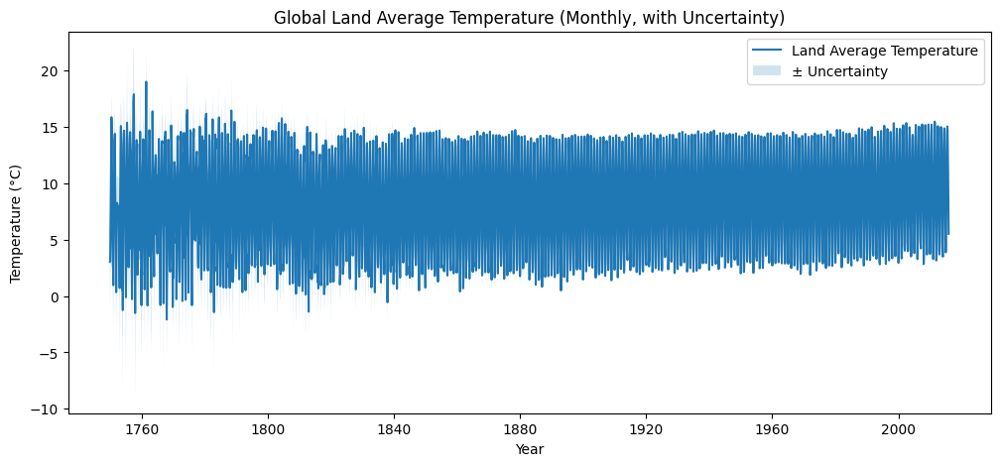

In [11]:
g = global_clean.sort_values("dt")

plt.figure(figsize=(12,5))
plt.plot(g["dt"], g["LandAverageTemperature"], label="Land Average Temperature")
plt.fill_between(
    g["dt"],
    g["LandAverageTemperature"] - g["LandAverageTemperatureUncertainty"],
    g["LandAverageTemperature"] + g["LandAverageTemperatureUncertainty"],
    alpha=0.2,
    label="± Uncertainty"
)
plt.title("Global Land Average Temperature (Monthly, with Uncertainty)")
plt.xlabel("Year")
plt.ylabel("Temperature (°C)")
plt.legend()
plt.show()


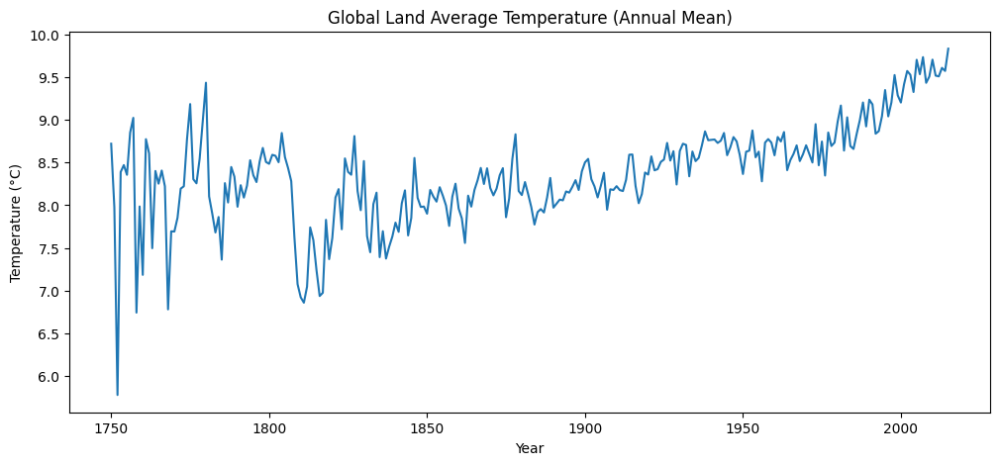

In [12]:
g_year = g.groupby("year", as_index=False)["LandAverageTemperature"].mean()

plt.figure(figsize=(12,5))
plt.plot(g_year["year"], g_year["LandAverageTemperature"])
plt.title("Global Land Average Temperature (Annual Mean)")
plt.xlabel("Year")
plt.ylabel("Temperature (°C)")
plt.show()


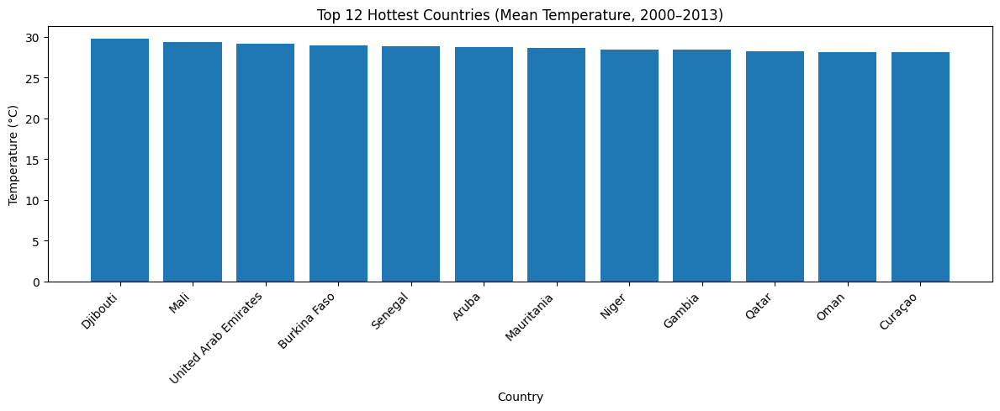

In [13]:
c_recent = country_clean[country_clean["year"].between(2000, 2013)]

top_hot = (
    c_recent.groupby("Country")["AverageTemperature"]
    .mean()
    .sort_values(ascending=False)
    .head(12)
    .reset_index()
)

plt.figure(figsize=(12,5))
plt.bar(top_hot["Country"], top_hot["AverageTemperature"])
plt.title("Top 12 Hottest Countries (Mean Temperature, 2000–2013)")
plt.xlabel("Country")
plt.ylabel("Temperature (°C)")
plt.xticks(rotation=45, ha="right")
plt.tight_layout()
plt.show()


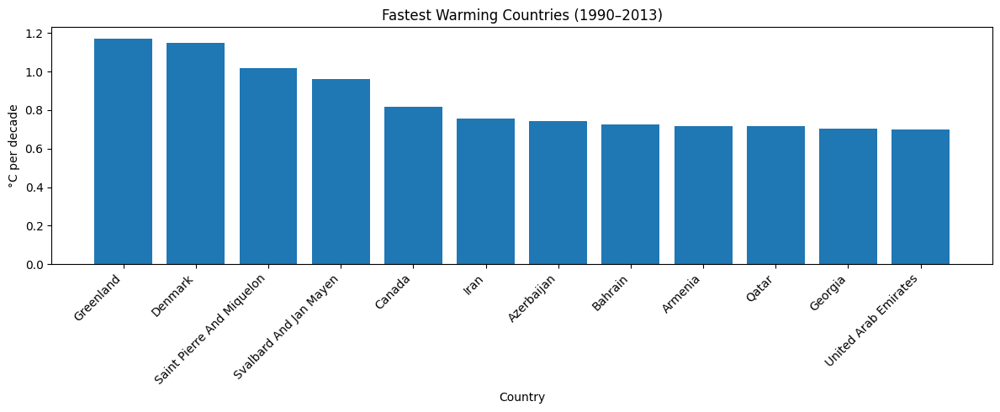

In [14]:
from numpy.polynomial.polynomial import polyfit

c_1990 = country_clean[country_clean["year"].between(1990, 2013)]

# keep countries with enough observations
cov = c_1990.groupby("Country")["year"].nunique()
good_countries = cov[cov >= 20].index
c_1990 = c_1990[c_1990["Country"].isin(good_countries)]

slopes = []
for country, grp in c_1990.groupby("Country"):
    y = grp.groupby("year")["AverageTemperature"].mean()
    x = y.index.values.astype(float)
    _, slope = polyfit(x, y.values, 1)
    slopes.append((country, slope * 10))  # °C per decade

slopes_df = pd.DataFrame(slopes, columns=["Country", "Slope_C_per_decade"])
top_warming = slopes_df.sort_values("Slope_C_per_decade", ascending=False).head(12)

plt.figure(figsize=(12,5))
plt.bar(top_warming["Country"], top_warming["Slope_C_per_decade"])
plt.title("Fastest Warming Countries (1990–2013)")
plt.xlabel("Country")
plt.ylabel("°C per decade")
plt.xticks(rotation=45, ha="right")
plt.tight_layout()
plt.show()


In [15]:
# =========================
# STATE — Heatmap (State x Year)
# =========================

state_year = (state_clean
              .groupby(["Country","State","year"], as_index=False)
              .agg(temp=("AverageTemperature","mean")))

# Exemple: un seul pays (sinon énorme)
selected_country = "Brazil"
tmp = state_year[state_year["Country"] == selected_country]

# pivoter (rows=State, cols=year)
pivot = tmp.pivot_table(index="State", columns="year", values="temp")

fig = px.imshow(
    pivot,
    aspect="auto",
    title=f"{selected_country} — State Temperatures (Heatmap by Year)",
    labels=dict(x="Year", y="State", color="°C")
)
fig.show()


ValueError: Mime type rendering requires nbformat>=4.2.0 but it is not installed

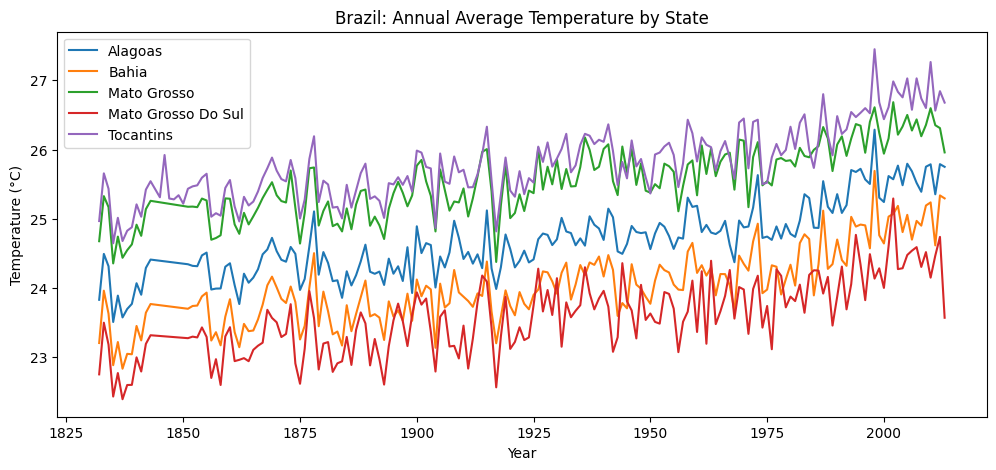

In [ ]:
country = "Brazil"

s = state_clean[state_clean["Country"] == country]

top_states = (
    s.groupby("State")["year"]
    .nunique()
    .sort_values(ascending=False)
    .head(5)
    .index
)

s_year = (
    s[s["State"].isin(top_states)]
    .groupby(["State","year"], as_index=False)["AverageTemperature"]
    .mean()
)

plt.figure(figsize=(12,5))
for state, grp in s_year.groupby("State"):
    plt.plot(grp["year"], grp["AverageTemperature"], label=state)

plt.title(f"{country}: Annual Average Temperature by State")
plt.xlabel("Year")
plt.ylabel("Temperature (°C)")
plt.legend()
plt.show()


In [ ]:
# =========================
# MAJOR CITIES — Animated map
# =========================

# 1) Agrégation annuelle (sinon trop de points)
mc_year = (major_city_clean
           .groupby(["year","City","Country","lat","lon"], as_index=False)
           .agg(temp=("AverageTemperature","mean"),
                unc=("AverageTemperatureUncertainty","mean")))

# 2) Choisir une période (recommandé pour être fluide)
mc_year = mc_year[mc_year["year"].between(1900, 2013)]

fig = px.scatter_geo(
    mc_year,
    lat="lat", lon="lon",
    color="temp",
    animation_frame="year",
    hover_name="City",
    hover_data={"Country": True, "temp":":.2f", "unc":":.2f", "lat":False, "lon":False},
    projection="natural earth",
    title="Major Cities — Mean Temperature (Animated by Year)"
)
fig.update_traces(marker=dict(size=5, opacity=0.75))
fig.show()


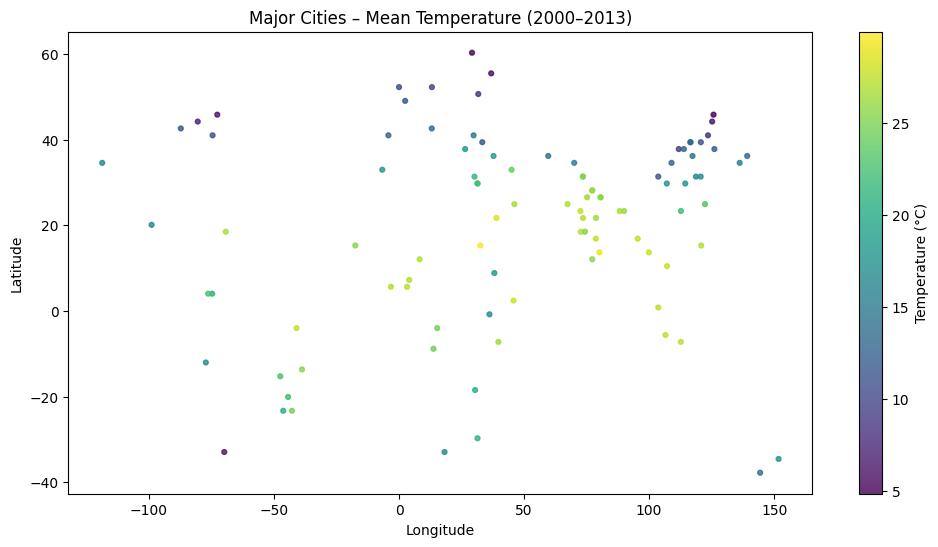

In [ ]:
m_recent = major_city_clean[major_city_clean["year"].between(2000, 2013)]

m_map = (
    m_recent.groupby(["City","Country","lat","lon"], as_index=False)
    ["AverageTemperature"]
    .mean()
)

plt.figure(figsize=(12,6))
plt.scatter(
    m_map["lon"], m_map["lat"],
    c=m_map["AverageTemperature"],
    s=12, alpha=0.8
)
plt.title("Major Cities – Mean Temperature (2000–2013)")
plt.xlabel("Longitude")
plt.ylabel("Latitude")
cb = plt.colorbar()
cb.set_label("Temperature (°C)")
plt.show()


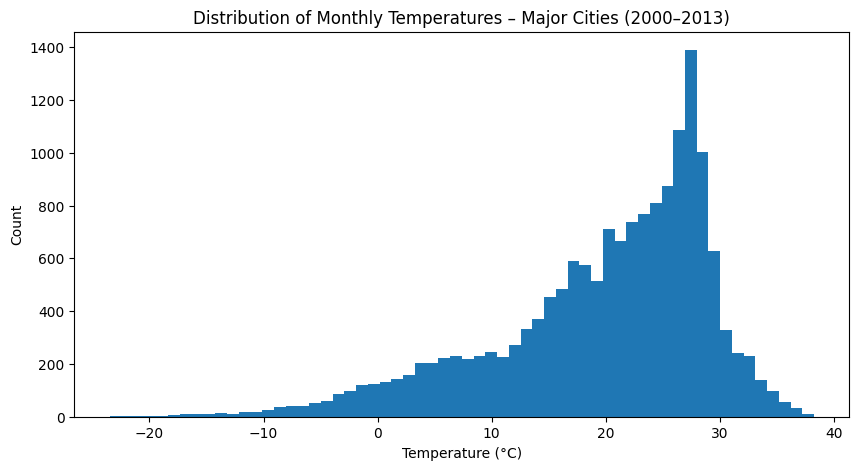

In [ ]:
plt.figure(figsize=(10,5))
plt.hist(m_recent["AverageTemperature"], bins=60)
plt.title("Distribution of Monthly Temperatures – Major Cities (2000–2013)")
plt.xlabel("Temperature (°C)")
plt.ylabel("Count")
plt.show()


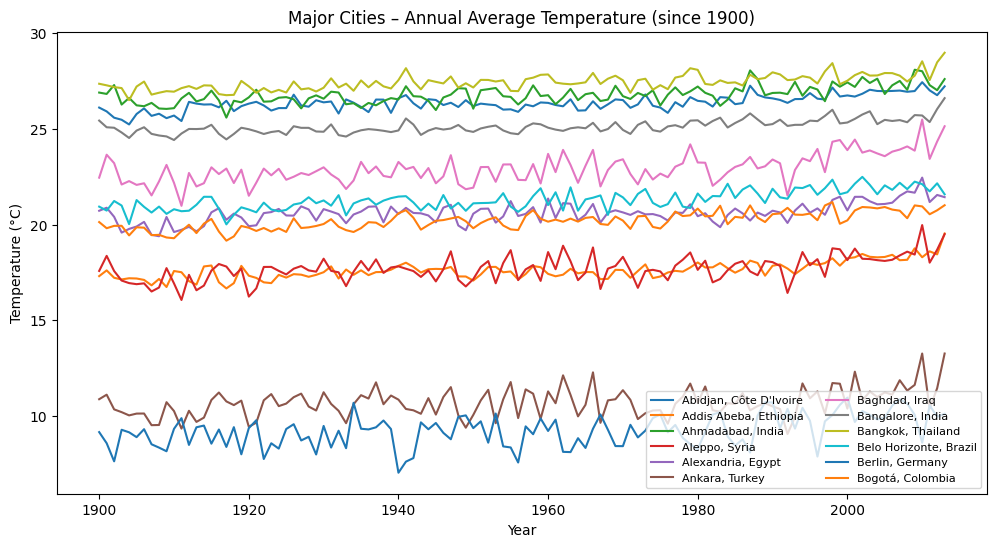

In [ ]:
m_long = major_city_clean[major_city_clean["year"] >= 1900]

top_cities = (
    m_long.groupby(["City","Country"])["year"]
    .nunique()
    .sort_values(ascending=False)
    .head(12)
    .index
)

m_long = m_long.set_index(["City","Country"]).loc[top_cities].reset_index()
m_year = m_long.groupby(["City","Country","year"], as_index=False)["AverageTemperature"].mean()

plt.figure(figsize=(12,6))
for (city, country), grp in m_year.groupby(["City","Country"]):
    plt.plot(grp["year"], grp["AverageTemperature"], label=f"{city}, {country}")

plt.title("Major Cities – Annual Average Temperature (since 1900)")
plt.xlabel("Year")
plt.ylabel("Temperature (°C)")
plt.legend(ncol=2, fontsize=8)
plt.show()


In [ ]:
# =========================
# ALL CITIES — Animated map (sample to keep it smooth)
# =========================

# 1) Annual aggregation
city_year = (city_clean
             .groupby(["year","City","Country","lat","lon"], as_index=False)
             .agg(temp=("AverageTemperature","mean"),
                  unc=("AverageTemperatureUncertainty","mean")))

city_year = city_year[city_year["year"].between(1900, 2013)]

# 2) Garder les villes avec bonne couverture
coverage = city_year.groupby(["City","Country"])["year"].nunique()
good = coverage[coverage >= 80].index  # ajuste: 50/80/100
city_year = city_year.set_index(["City","Country"]).loc[good].reset_index()

# 3) OPTION: limiter à 1500 villes max pour fluidité
# (sinon animation lourde)
np.random.seed(42)
pairs = city_year[["City","Country"]].drop_duplicates()
if len(pairs) > 1500:
    keep_pairs = pairs.sample(1500, random_state=42)
    city_year = city_year.merge(keep_pairs, on=["City","Country"], how="inner")

fig = px.scatter_geo(
    city_year,
    lat="lat", lon="lon",
    color="temp",
    animation_frame="year",
    hover_name="City",
    hover_data={"Country": True, "temp":":.2f", "unc":":.2f", "lat":False, "lon":False},
    projection="natural earth",
    title="All Cities — Mean Temperature (Animated by Year, sampled)"
)
fig.update_traces(marker=dict(size=3, opacity=0.65))
fig.show()


## PART 1 — Machine Learning (Unsupervised)

### Detecting local seasonal climate anomalies

In this section, we aim to automatically detect unusual climate observations at the *(city — year — season)* level, without using labels.  
Therefore, the task is formulated as an **unsupervised anomaly detection problem**.

Before applying an anomaly detector (Isolation Forest), we build climate-relevant features:

### 1) Seasonal aggregation
Monthly temperatures are aggregated per **city, country, year, and season** to reduce short-term noise while preserving the seasonal structure of climate behavior.

### 2) Climatology baseline and temperature anomaly
For each *(city × country × season)*, we compute a **climatology baseline** over a fixed reference window (1951–1980).  
We then compute the temperature anomaly:

\[
temp\_anomaly = T_{observed} - T_{baseline}
\]

This allows the analysis to focus on deviations from local climate rather than raw temperatures.

### 3) Uncertainty-aware deviation
Measurement uncertainty is higher in early historical records. To avoid flagging noisy observations as anomalies, we compute an uncertainty-aware normalized deviation:

\[
\sigma\_dev = \frac{|temp\_anomaly|}{uncertainty + \varepsilon}
\]

This makes anomaly detection more robust and more interpretable.


In [16]:
import numpy as np
import pandas as pd

# ==============================
# ML — Step 1: pivot dataset + climatology baseline
# ==============================

# 1) Define meteorological seasons
def get_season(month):
    if month in [12, 1, 2]:
        return "Winter"
    elif month in [3, 4, 5]:
        return "Spring"
    elif month in [6, 7, 8]:
        return "Summer"
    else:
        return "Autumn"

# 2) Preparation (monthly -> season)
ml_df = city_clean.copy()
ml_df["season"] = ml_df["month"].apply(get_season)

# 3) Aggregation City × Country × Year × Season
# IMPORTANT: city_seasonal_clean is reused in the Deep Learning section
city_seasonal_clean = ml_df.groupby(
    ["City", "Country", "year", "season"]
).agg({
    "AverageTemperature": "mean",
    "AverageTemperatureUncertainty": "mean",
    "lat": "first",
    "lon": "first"
}).reset_index()

print("✅ city_seasonal_clean shape =", city_seasonal_clean.shape)
display(city_seasonal_clean.head())

# 4) Harmonized climatology baseline (1951–1980 window)
CLIM_START, CLIM_END = 1951, 1980

clim_window = city_seasonal_clean[
    city_seasonal_clean["year"].between(CLIM_START, CLIM_END)
].copy()

baseline = clim_window.groupby(
    ["City", "Country", "season"]
)["AverageTemperature"].mean().reset_index()

baseline = baseline.rename(columns={"AverageTemperature": "baseline_temp"})

# Merge baseline back into full dataset
city_seasonal_clean = city_seasonal_clean.merge(
    baseline,
    on=["City", "Country", "season"],
    how="left"
)

# 5) temp_anomaly (shared ML / DL definition)
city_seasonal_clean["temp_anomaly"] = (
    city_seasonal_clean["AverageTemperature"] - city_seasonal_clean["baseline_temp"]
)

# 6) sigma_dev = anomaly normalized by uncertainty
eps = 1e-6
city_seasonal_clean["sigma_dev"] = (
    city_seasonal_clean["temp_anomaly"].abs()
    / (city_seasonal_clean["AverageTemperatureUncertainty"] + eps)
)

# 7) Quick checks
print("\n✅ Missing baseline rate:", city_seasonal_clean["baseline_temp"].isna().mean())
print("✅ sigma_dev stats:")
display(city_seasonal_clean["sigma_dev"].describe())

display(city_seasonal_clean[[
    "City", "Country", "year", "season",
    "AverageTemperature", "baseline_temp",
    "temp_anomaly", "AverageTemperatureUncertainty", "sigma_dev"
]].head(10))


✅ city_seasonal_clean shape = (2744859, 8)


,City,Country,year,season,AverageTemperature,AverageTemperatureUncertainty,lat,lon
0,A Coruña,Spain,1743,Autumn,10.779000,1.942000,42.59,-8.73
1,A Coruña,Spain,1744,Autumn,13.333333,1.899333,42.59,-8.73
2,A Coruña,Spain,1744,Spring,13.112500,2.016500,42.59,-8.73
3,A Coruña,Spain,1744,Summer,17.201000,1.871000,42.59,-8.73
4,A Coruña,Spain,1744,Winter,8.798000,2.037000,42.59,-8.73



✅ Missing baseline rate: 0.0
✅ sigma_dev stats:


count    2.744859e+06
mean     1.273173e+00
std      1.658141e+00
min      0.000000e+00
25%      3.134607e-01
50%      7.193563e-01
75%      1.559863e+00
max      3.664919e+01
Name: sigma_dev, dtype: float64

,City,Country,year,season,AverageTemperature,baseline_temp,temp_anomaly,AverageTemperatureUncertainty,sigma_dev
0,A Coruña,Spain,1743,Autumn,10.779000,14.323344,-3.544344,1.942000,1.825099
1,A Coruña,Spain,1744,Autumn,13.333333,14.323344,-0.990011,1.899333,0.521241
2,A Coruña,Spain,1744,Spring,13.112500,11.843356,1.269144,2.016500,0.629380
3,A Coruña,Spain,1744,Summer,17.201000,17.780056,-0.579056,1.871000,0.309490
4,A Coruña,Spain,1744,Winter,8.798000,8.856711,-0.058711,2.037000,0.028822
5,A Coruña,Spain,1745,Spring,10.239500,11.843356,-1.603856,1.874000,0.855846
6,A Coruña,Spain,1745,Winter,8.101500,8.856711,-0.755211,1.972500,0.382870
7,A Coruña,Spain,1750,Autumn,14.417500,14.323344,0.094156,1.777500,0.052971
8,A Coruña,Spain,1750,Spring,12.426333,11.843356,0.582978,1.974000,0.295328
9,A Coruña,Spain,1750,Summer,18.586000,17.780056,0.805944,1.752667,0.459839


**Global output (shape + baseline missing + sigma_dev stats)**

Seasonal aggregation yields 2,744,859 (city–year–season) observations, providing a robust basis for anomaly detection.

The baseline missing rate is 0, and sigma_dev enables more reliable detection despite higher uncertainty in early records.

**Preview of the enriched dataset (baseline_temp, temp_anomaly, sigma_dev)**

baseline_temp defines a climatology reference (1951–1980) per city/country/season, enabling temp_anomaly as a deviation from local climate.

sigma_dev normalizes this deviation by uncertainty, reducing over-detection of anomalies caused by historical measurement noise.

## Step 2 — Temporal detrending (removing trend bias)

Over long climate time series, temperatures exhibit a strong background trend (global warming).  
If this trend is not removed, an anomaly detector may incorrectly flag entire periods as anomalous simply because they belong to a warmer or colder era.

To focus on *punctual* anomalies (unusual deviations), we apply a **linear detrending** per *(City × Country × season)* group on the `temp_anomaly` variable.

- `temp_anomaly` captures the deviation from the reference climatology (1951–1980)
- `temp_residual` captures short-term fluctuations around the local trend

Anomalies will be detected using `temp_residual` (and the uncertainty-aware feature `sigma_dev`).


In [17]:
import numpy as np
import pandas as pd
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import StandardScaler

# ==============================
# ML — Step 2: detrending + feature preparation
# ==============================

df_ml = city_seasonal_clean.copy()

# 1) Time filtering (optional but recommended)
# -> avoids very early sparse/noisy records
df_ml = df_ml[df_ml["year"] >= 1900].copy()

print("✅ After filtering (year >= 1900):", df_ml.shape)
print("Years:", df_ml["year"].min(), "→", df_ml["year"].max())


# 2) Linear detrending per (City, Country, season) on temp_anomaly
def detrend_group(group):
    group = group.sort_values("year").copy()

    # If too few points: simple fallback
    if len(group) < 8:
        group["temp_residual"] = group["temp_anomaly"] - group["temp_anomaly"].mean()
        return group

    X = group[["year"]].values
    y = group["temp_anomaly"].values

    lr = LinearRegression()
    lr.fit(X, y)

    group["temp_residual"] = y - lr.predict(X)
    return group


print("⏳ Detrending per City × Country × season...")
df_ml = df_ml.groupby(["City", "Country", "season"], group_keys=False).apply(detrend_group)
print("✅ Detrending done.")

display(df_ml[[
    "City", "Country", "year", "season",
    "temp_anomaly", "temp_residual",
    "AverageTemperatureUncertainty", "sigma_dev"
]].head(10))


# 3) One-hot encoding season (for Isolation Forest)
df_ml = pd.get_dummies(df_ml, columns=["season"], drop_first=True)
season_cols = [c for c in df_ml.columns if c.startswith("season_")]

# 4) Feature selection for ML
# IMPORTANT: temp_residual is the main feature
features_ml = [
    "temp_residual",
    "sigma_dev",
    "lat",
    "lon"
] + season_cols

X = df_ml[features_ml].copy()

# 5) Standardization
scaler_ml = StandardScaler()
X_scaled = scaler_ml.fit_transform(X)

print("\n✅ ML features ready:")
print("Number of samples:", X.shape[0])
print("Number of features:", X.shape[1])
print("Feature columns:", features_ml)


✅ After filtering (year >= 1900): (1588381, 11)
Years: 1900 → 2013
⏳ Detrending per City × Country × season...
✅ Detrending done.


C:\Users\cande\AppData\Local\Temp\ipykernel_6780\178992086.py:40: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



,City,Country,year,season,temp_anomaly,temp_residual,AverageTemperatureUncertainty,sigma_dev
606,A Coruña,Spain,1900,Autumn,0.184322,0.688773,0.816333,0.225793
607,A Coruña,Spain,1900,Spring,-0.619689,-0.274398,0.756667,0.818971
608,A Coruña,Spain,1900,Summer,0.259944,0.500432,0.700333,0.371172
609,A Coruña,Spain,1900,Winter,0.443622,0.867164,0.816333,0.543432
610,A Coruña,Spain,1901,Autumn,-1.243344,-0.749542,0.630333,1.972516
611,A Coruña,Spain,1901,Spring,0.000311,0.334849,0.897333,0.000347
612,A Coruña,Spain,1901,Summer,1.277278,1.507962,1.019667,1.252641
613,A Coruña,Spain,1901,Winter,-1.744044,-1.329986,0.845333,2.063142
614,A Coruña,Spain,1902,Autumn,-0.539011,-0.055858,0.519333,1.037888
615,A Coruña,Spain,1902,Spring,-0.066356,0.257429,0.615333,0.107837



✅ ML features ready:
Number of samples: 1588381
Number of features: 7
Feature columns: ['temp_residual', 'sigma_dev', 'lat', 'lon', 'season_Spring', 'season_Summer', 'season_Winter']


**Time filtering + detrending completed**

After filtering (≥1900), we keep 1,588,381 observations spanning 1900–2013, ensuring more reliable measurements.

Detrending per (City×Country×season) produces temp_residual, a centered signal suitable for detecting punctual anomalies.

**Preview of residuals (temp_residual) and sigma_dev**

temp_residual values represent deviations from expected behavior after removing the local trend, with both positive and negative fluctuations.

sigma_dev normalizes these deviations by uncertainty, reducing false anomalies caused by noisy historical measurements.

**ML features ready (final dimensionality)**

The final dataset contains 1,588,381 samples and 7 features, combining climate signal (temp_residual), robustness (sigma_dev), and spatio-seasonal context.

This representation is ready to train Isolation Forest in a consistent and interpretable feature space.

### Step 3 — Anomaly detection with Isolation Forest (calibrated threshold)

We now apply **Isolation Forest**, an unsupervised algorithm well-suited for anomaly detection on unlabeled data.

### Why a calibrated threshold?
The `contamination` parameter may artificially impose a fixed anomaly rate.  
To avoid this bias, we rely on the **continuous anomaly score** produced by Isolation Forest and define a threshold based on the score distribution observed during a historical training period assumed to be mostly normal.

### Method
- train the model on a historical period
- compute an anomaly score (`if_score`)
- threshold = high quantile (e.g., 99.5%) of train scores
- an observation is anomalous if its score exceeds the threshold

This makes the anomaly definition more rigorous and comparable to standard threshold-based detection.



In [18]:
from sklearn.ensemble import IsolationForest
import numpy as np
import pandas as pd

# ==============================
# ML — Step 3: Isolation Forest + scoring + quantile threshold
# ==============================

# 1) Time split (train / test)
train_mask = df_ml["year"] <= 1980
test_mask  = df_ml["year"] > 1980

X_train = X_scaled[train_mask]
X_test  = X_scaled[test_mask]

print("✅ IF split:")
print("Train:", X_train.shape, "| years <= 1980")
print("Test :", X_test.shape,  "| years > 1980")

# 2) Train Isolation Forest
iso = IsolationForest(
    n_estimators=300,
    contamination=0.01,  # not used as final threshold
    random_state=42,
    n_jobs=-1
)
iso.fit(X_train)

# 3) Scores
# decision_function: higher = more normal
# invert so that higher = more anomalous
train_scores = -iso.decision_function(X_train)
test_scores  = -iso.decision_function(X_test)

# 4) Threshold calibrated on TRAIN
Q = 99.5
threshold = np.percentile(train_scores, Q)

print(f"\n✅ Calibrated threshold: {Q}th percentile on TRAIN")
print("Threshold =", threshold)

# 5) Add scores back to dataframe
df_ml["if_score"] = -iso.decision_function(X_scaled)
df_ml["if_anomaly"] = df_ml["if_score"] > threshold

# 6) Anomaly rates
train_rate = df_ml.loc[train_mask, "if_anomaly"].mean()
test_rate  = df_ml.loc[test_mask,  "if_anomaly"].mean()

print("\n✅ Anomaly rates:")
print(f"Train anomaly rate: {train_rate:.4f} ({train_rate*100:.2f}%)")
print(f"Test anomaly rate : {test_rate:.4f} ({test_rate*100:.2f}%)")

# 7) Top anomalies
top_anoms = df_ml[df_ml["if_anomaly"]].sort_values("if_score", ascending=False).head(15)
print("\n✅ Top 15 IF anomalies:")
display(top_anoms[[
    "City", "Country", "year",
    "temp_residual", "sigma_dev",
    "AverageTemperatureUncertainty",
    "if_score"
]])


✅ IF split:
Train: (1130760, 7) | years <= 1980
Test : (457621, 7) | years > 1980

✅ Calibrated threshold: 99.5th percentile on TRAIN
Threshold = 0.01979927653114785

✅ Anomaly rates:
Train anomaly rate: 0.0050 (0.50%)
Test anomaly rate : 0.0119 (1.19%)

✅ Top 15 IF anomalies:


,City,Country,year,temp_residual,sigma_dev,AverageTemperatureUncertainty,if_score
87302,Anchorage,United States,2013,3.519996,10.689593,0.537000,0.074665
87191,Anchorage,United States,1985,4.118966,9.962602,0.571000,0.074345
87259,Anchorage,United States,2002,3.751603,9.952952,0.574333,0.074345
87195,Anchorage,United States,1986,4.234396,9.658529,0.603333,0.073065
50816,Albury,Australia,2013,2.260084,16.317595,0.174000,0.073004
685348,Edmonton,Canada,1987,5.872066,23.697576,0.307667,0.072209
685124,Edmonton,Canada,1931,7.321682,18.728468,0.396667,0.072209
685112,Edmonton,Canada,1928,5.453281,13.760144,0.399000,0.071092
685424,Edmonton,Canada,2006,4.286053,13.526314,0.454667,0.071092
685364,Edmonton,Canada,1991,3.524045,12.205086,0.412667,0.070455


**Isolation Forest results (split, threshold, anomaly rates)**

The model is trained on 1900–1980 (1,130,760 samples) and tested on 1981–2013 (457,621 samples), preventing temporal leakage.

Using a 99.5th percentile threshold calibrated on train scores, anomaly rates are 0.50% (train) and 1.19% (test), suggesting more atypical events in the recent period.

**Top detected anomalies (table)**

The most extreme anomalies combine large residuals (temp_residual) with high sigma_dev, meaning strong deviations despite relatively low uncertainty.

The recurrence of specific cities/years (e.g., Anchorage 2013, Edmonton, etc.) suggests regional/temporal coherence rather than random noise.

### Step 4 — Qualitative validation and temporal analysis of anomalies

Since no anomaly labels are available, evaluation must rely on:
- **qualitative validation** (overlaying anomalies on time series),
- and structured analysis of anomaly frequency over time.

In this step, we:
1) visualize `temp_residual` time series for selected cities with detected anomalies overlaid,
2) analyze anomaly counts/rates per year and per decade to identify globally atypical periods.


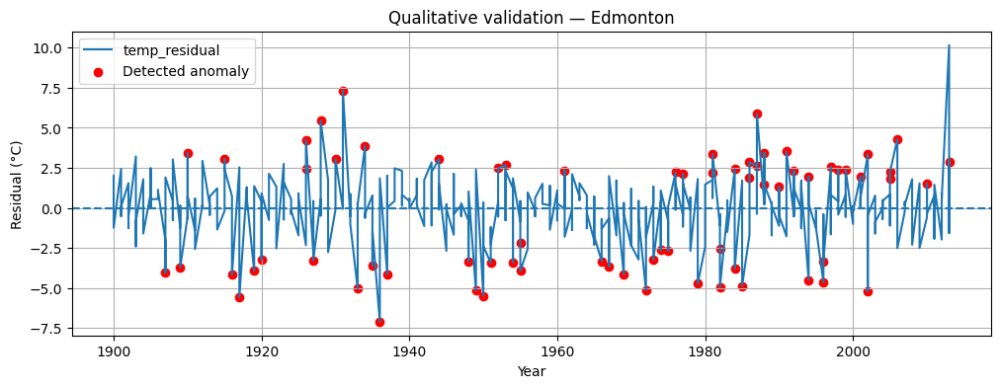

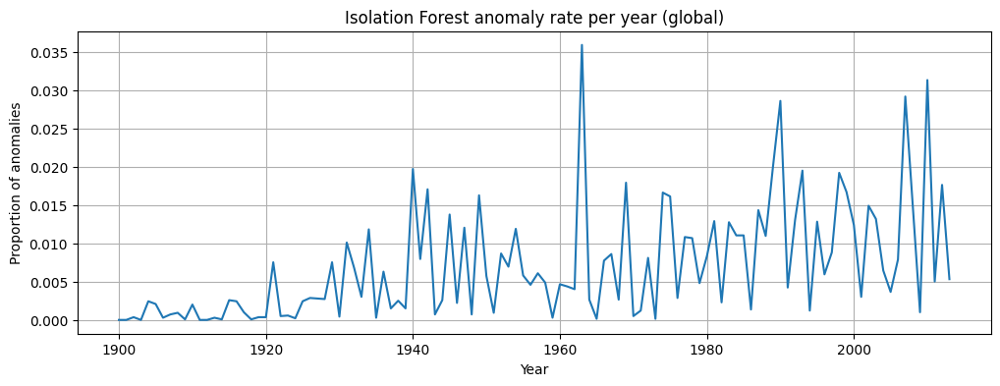

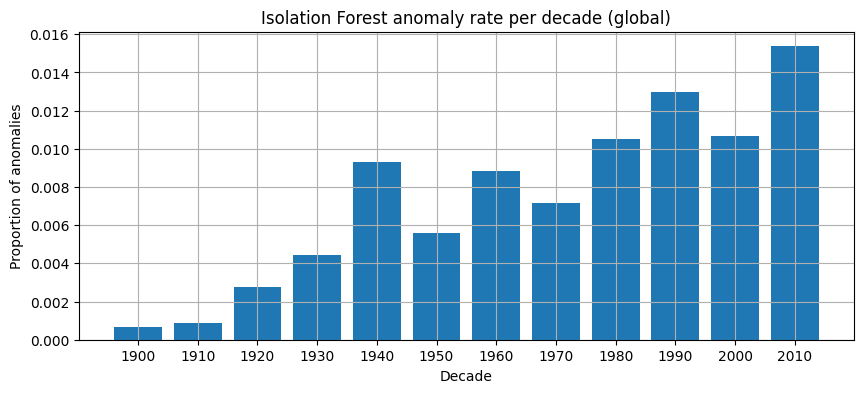

✅ Top 10 years with most IF anomalies:


,year,nb_anomalies,total,anomaly_rate
63,1963,501,13960,0.035888
110,2010,437,13960,0.031304
107,2007,407,13960,0.029155
90,1990,399,13960,0.028582
89,1989,280,13960,0.020057
40,1940,275,13960,0.019699
93,1993,272,13960,0.019484
98,1998,268,13960,0.019198
69,1969,250,13960,0.017908
112,2012,246,13960,0.017622


In [19]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# ==============================
# ML — Step 4: qualitative validation + temporal analysis
# ==============================

# 1) Qualitative validation (choose one representative city)
city_example = df_ml[df_ml["if_anomaly"]]["City"].value_counts().index[0]

tmp = df_ml[df_ml["City"] == city_example].sort_values("year")

plt.figure(figsize=(12,4))
plt.plot(tmp["year"], tmp["temp_residual"], label="temp_residual")
plt.scatter(
    tmp[tmp["if_anomaly"]]["year"],
    tmp[tmp["if_anomaly"]]["temp_residual"],
    color="red",
    label="Detected anomaly"
)
plt.axhline(0, linestyle="--")
plt.title(f"Qualitative validation — {city_example}")
plt.xlabel("Year")
plt.ylabel("Residual (°C)")
plt.legend()
plt.grid(True)
plt.show()


# 2) Anomaly count and rate per year
year_stats = df_ml.groupby("year").agg(
    nb_anomalies=("if_anomaly", "sum"),
    total=("if_anomaly", "count")
).reset_index()

year_stats["anomaly_rate"] = year_stats["nb_anomalies"] / year_stats["total"]

plt.figure(figsize=(12,4))
plt.plot(year_stats["year"], year_stats["anomaly_rate"])
plt.title("Isolation Forest anomaly rate per year (global)")
plt.xlabel("Year")
plt.ylabel("Proportion of anomalies")
plt.grid(True)
plt.show()


# 3) Per-decade analysis (more readable)
df_ml["decade"] = (df_ml["year"] // 10) * 10

decade_stats = df_ml.groupby("decade").agg(
    nb_anomalies=("if_anomaly", "sum"),
    total=("if_anomaly", "count")
).reset_index()

decade_stats["anomaly_rate"] = decade_stats["nb_anomalies"] / decade_stats["total"]

plt.figure(figsize=(10,4))
plt.bar(decade_stats["decade"].astype(str), decade_stats["anomaly_rate"])
plt.title("Isolation Forest anomaly rate per decade (global)")
plt.xlabel("Decade")
plt.ylabel("Proportion of anomalies")
plt.grid(True)
plt.show()


# 4) Top years
top_years = year_stats.sort_values("nb_anomalies", ascending=False).head(10)
print("✅ Top 10 years with most IF anomalies:")
display(top_years)


**Qualitative validation — Edmonton**

Detected anomalies (red points) match the most extreme positive/negative peaks of temp_residual, providing qualitative validation of the model.

Anomalies occur across multiple periods, suggesting punctual deviations rather than a mere trend effect.

**Anomaly rate per year (global)**

The anomaly rate varies substantially across years, with clear spikes highlighting globally atypical periods.

Variability increases in recent decades, consistent with a rise in extreme climate fluctuations.

**Anomaly rate per decade (global)**

Anomaly frequency increases steadily across decades, with notably higher levels from the 1980s–1990s onward.

This suggests a shift toward more frequent atypical climate deviations in recent periods.

**Top 10 most anomalous years (Isolation Forest)**
The most anomalous years include both an older year (1963) and several recent years (e.g., 2010, 2007, 2012), indicating extreme episodes across time.

These years concentrate a large share of detected anomalies worldwide, reinforcing the temporal coherence of the detections.

### Step 5 — Statistical baseline (Z-score) and comparison with Isolation Forest

To assess the robustness of our ML approach, we compare Isolation Forest with a simple and interpretable statistical baseline: the **Z-score**.

### Z-score baseline
For each *(City × Country × season)*, we compute:

\[
z = \frac{temp\_residual - \mu}{\sigma}
\]

An observation is considered anomalous if \(|z| > 3\).

### Objectives
- check whether Isolation Forest detects the same anomalies as Z-score
- measure overlap between methods (common vs method-specific anomalies)
- analyze temporal evolution of anomalies according to both approaches

This comparison highlights the added value of Isolation Forest beyond simple extreme-value detection.


✅ Anomaly rates:
Isolation Forest: 0.0070 (0.70%)
Z-score baseline: 0.0034 (0.34%)

✅ Overlap IF vs Z-score:
Common anomalies : 1228
Only IF          : 9892
Only Z-score     : 4234


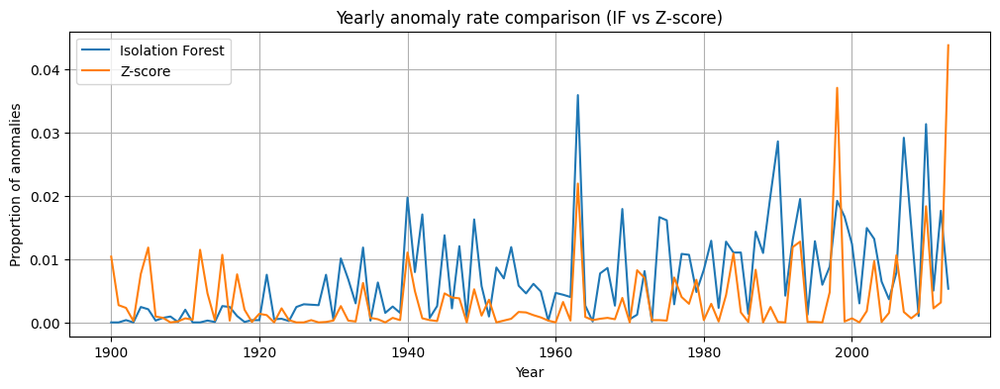


✅ Top 15 robust anomalies (IF & Z-score):


,City,Country,year,season_label,temp_residual,sigma_dev,if_score,z_score
2155185,Saskatoon,Canada,1931,Winter,8.617919,17.273204,0.068938,3.250760
2005492,Regina,Canada,1931,Winter,8.804023,14.150508,0.065113,3.323915
685406,Edmonton,Canada,2002,Spring,-5.191206,15.325333,0.062200,-3.002372
11475,Abilene,United States,2011,Summer,3.926122,18.884047,0.058812,3.944633
70787,Amarillo,United States,2011,Summer,3.893959,16.344633,0.058577,4.208294
2230720,Sioux Falls,United States,1931,Winter,6.618097,23.365193,0.058186,3.073286
2614910,Wichita Falls,United States,2011,Summer,4.587365,16.799274,0.058108,4.194296
2618186,Winnipeg,Canada,1931,Winter,6.933947,13.765677,0.058062,3.008982
2614779,Wichita Falls,United States,1978,Winter,-4.225697,12.952697,0.058020,-3.096058
408768,Calgary,Canada,2002,Spring,-5.323535,12.487639,0.057972,-3.185743


In [20]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# ==============================
# ML — Step 5: Z-score baseline + IF vs Z-score comparison
# ==============================

df_cmp = df_ml.copy()

# 1) Rebuild season label (since season was one-hot encoded)
season_map = {
    (0,0,0): "Autumn",
    (1,0,0): "Spring",
    (0,1,0): "Summer",
    (0,0,1): "Winter"
}
df_cmp["season_label"] = df_cmp.apply(
    lambda r: season_map.get(
        (int(r.get("season_Spring",0)), int(r.get("season_Summer",0)), int(r.get("season_Winter",0))),
        "Autumn"
    ),
    axis=1
)

# Z-score on temp_residual per group
df_cmp["z_score"] = df_cmp.groupby(["City", "Country", "season_label"])["temp_residual"].transform(
    lambda x: (x - x.mean()) / (x.std() if x.std() > 0 else np.nan)
)

df_cmp["z_anomaly"] = df_cmp["z_score"].abs() > 3

# 2) Quantitative comparison
if_rate = df_cmp["if_anomaly"].mean()
z_rate = df_cmp["z_anomaly"].mean()

both = (df_cmp["if_anomaly"] & df_cmp["z_anomaly"]).sum()
only_if = (df_cmp["if_anomaly"] & ~df_cmp["z_anomaly"]).sum()
only_z  = (~df_cmp["if_anomaly"] & df_cmp["z_anomaly"]).sum()

print("✅ Anomaly rates:")
print(f"Isolation Forest: {if_rate:.4f} ({if_rate*100:.2f}%)")
print(f"Z-score baseline: {z_rate:.4f} ({z_rate*100:.2f}%)")

print("\n✅ Overlap IF vs Z-score:")
print("Common anomalies :", both)
print("Only IF          :", only_if)
print("Only Z-score     :", only_z)

# 3) Temporal comparison: yearly anomaly rate
year_cmp = df_cmp.groupby("year").agg(
    if_rate=("if_anomaly", "mean"),
    z_rate=("z_anomaly", "mean")
).reset_index()

plt.figure(figsize=(12,4))
plt.plot(year_cmp["year"], year_cmp["if_rate"], label="Isolation Forest")
plt.plot(year_cmp["year"], year_cmp["z_rate"], label="Z-score")
plt.title("Yearly anomaly rate comparison (IF vs Z-score)")
plt.xlabel("Year")
plt.ylabel("Proportion of anomalies")
plt.legend()
plt.grid(True)
plt.show()

# 4) Robust anomalies (detected by both)
robust_anoms = df_cmp[df_cmp["if_anomaly"] & df_cmp["z_anomaly"]].sort_values(
    "if_score", ascending=False
).head(15)

print("\n✅ Top 15 robust anomalies (IF & Z-score):")
display(robust_anoms[[
    "City", "Country", "year", "season_label",
    "temp_residual", "sigma_dev", "if_score", "z_score"
]])


**IF vs Z-score comparison (rates + overlap)**

Isolation Forest detects more anomalies (0.70%) than the Z-score baseline (0.34%), suggesting it captures more complex atypical patterns beyond simple extremes.

The overlap yields 1228 robust anomalies (common detections), while “Only IF” anomalies highlight the added value of multivariate detection (residual + uncertainty + context).

**Yearly anomaly rate (IF vs Z-score)**

Both methods show spikes for specific years, but Isolation Forest provides a smoother curve and appears more sensitive to broader global variability.

Strong peaks in recent decades suggest an increased frequency of atypical climate deviations in modern periods.

**Top robust anomalies (IF & Z-score)**

Anomalies detected by both methods correspond to very extreme events (|z|>3) with high if_score, hence strongly atypical.

The recurrence of winter anomalies in North America and Russia suggests the model captures climatologically plausible and coherent events.

### Conclusion — Machine Learning section

In this section, we built a complete and robust baseline for detecting local climate anomalies from historical temperature data.

Our ML pipeline relies on:
- seasonal aggregation *(City — Country — Year — Season)*,
- a climatology-based anomaly definition through `temp_anomaly` (deviation from a 1951–1980 baseline),
- temporal detrending (`temp_residual`) to avoid confusing climate trend with punctual anomalies,
- explicit uncertainty awareness through `sigma_dev`,
- and an unsupervised model (Isolation Forest) using a **calibrated threshold** on a training period (quantile-based).

Results show:
- temporal coherence (yearly peaks and an increased anomaly frequency in recent decades),
- spatial coherence (recurrent cities/countries),
- and improved robustness via comparison with a Z-score baseline (common anomalies).

However, this approach is mostly *point-wise* (detecting anomalies observation by observation) and does not explicitly model long-term temporal dependencies or regime changes in climate time series.

Therefore, in the next section we use **sequential Deep Learning models**, able to learn normal temporal dynamics and detect anomalies using reconstruction/prediction errors.
